In [84]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt

from altair import *

from nltk import tokenize
from nltk.corpus import stopwords
import string
import re
import random
from collections import Counter
from wordcloud import *
import os
import math

In [2]:
translator = str.maketrans({key: None for key in string.punctuation})
# mystr.translate(translator) - will remove all punctuation


In [3]:
ll = tokenize.word_tokenize('The quick, brown, fox.  Jumped over the "lazy" dog')

In [4]:
tweets = pd.read_csv('AirlineTweets.csv')
tweets.head()

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,570306133677760513,neutral,1.0000,NaN,NaN,Virgin America,NaN,cairdin,NaN,0,@VirginAmerica What @dhepburn said.,NaN,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,570301130888122368,positive,0.3486,NaN,0.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica plus you've added commercials t...,NaN,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,570301083672813571,neutral,0.6837,NaN,NaN,Virgin America,NaN,yvonnalynn,NaN,0,@VirginAmerica I didn't today... Must mean I n...,NaN,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,570301031407624196,negative,1.0000,Bad Flight,0.7033,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica it's really aggressive to blast...,NaN,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,570300817074462722,negative,1.0000,Can't Tell,1.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica and it's a really big bad thing...,NaN,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)


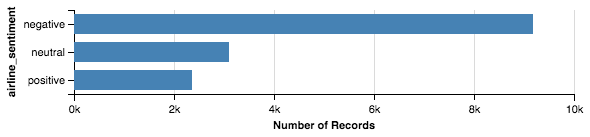

In [5]:
Chart(tweets).mark_bar().encode(
x = 'count(airline_sentiment):Q',
y = 'airline_sentiment')

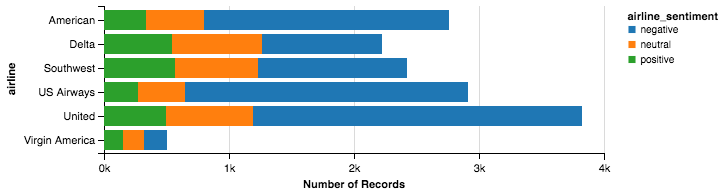

In [6]:
Chart(tweets).mark_bar().encode(
    x = 'count(airline_sentiment):Q',
    y = 'airline',
    color='airline_sentiment'
)

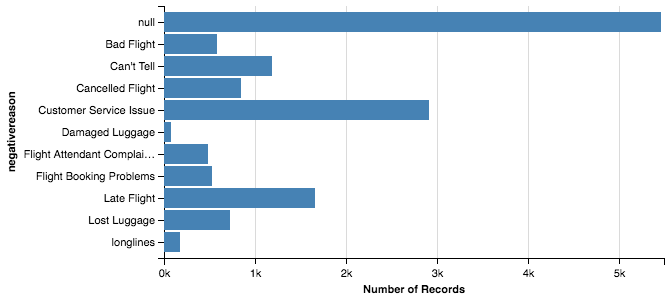

In [7]:
Chart(tweets).mark_bar().encode(
x = 'count(negativereason):Q',
y = 'negativereason')

In [8]:
translator = str.maketrans({key: None for key in string.punctuation})
def cleanText(tweet):
    tweet = tweet.lower()
    tweet = tweet.translate(translator)
    tweet = re.sub(r'\b\w\b', '', tweet)
    return tweet

    

In [9]:
tweets['clean_text'] = tweets.text.map(cleanText)

In [10]:
tweets['rand'] = [random.random() for x in range(len(tweets))]
tweets.sort_values('rand')

In [11]:
training_set = tweets.head(int(len(tweets)*.8))

In [12]:
test_set = tweets.tail(int(len(tweets)*.2))

In [13]:
pos = Counter()
neg = Counter()

In [14]:
sw = set(stopwords.words())

In [15]:
for i,row in training_set.iterrows():
    if row['airline_sentiment'] == 'negative':
        neg.update([x for x in row.clean_text.split() if x not in sw])
    elif row.airline_sentiment == 'positive':
        pos.update([x for x in row.clean_text.split() if x not in sw])

In [18]:
pdf = pd.DataFrame(dict(words=list(pos.keys()),count=list(pos.values())))

In [19]:
ndf = pd.DataFrame(dict(words=list(neg.keys()),count=list(neg.values())))

In [46]:
model = pd.merge(pdf, ndf, on='words', how='outer')
model.columns = ['p_count','word','n_count']

In [47]:
model.head()

,p_count,word,n_count
0,1.0,httptcokl9baimes6,NaN
1,1.0,1055,1.0
2,1.0,covered,NaN
3,1.0,676,NaN
4,1.0,goodenoughmother,1.0


In [48]:
model = model.fillna(0.0)
model.p_count = model.p_count.map(lambda x : x+1)
model.n_count = model.n_count.map(lambda x : x+1)



In [49]:
model.head()


,p_count,word,n_count
0,2.0,httptcokl9baimes6,1.0
1,2.0,1055,2.0
2,2.0,covered,1.0
3,2.0,676,1.0
4,2.0,goodenoughmother,2.0


In [23]:
model.sort_values('n_count',ascending=False).head(20)

,p_count,word,n_count
1889,518.0,united,2849.0
3857,323.0,flight,2235.0
4062,246.0,usairways,2193.0
1433,570.0,southwestair,1205.0
2194,573.0,jetblue,1031.0
3382,97.0,get,703.0
2645,31.0,cancelled,616.0
425,131.0,service,567.0
2183,7.0,hold,479.0
1395,6.0,hours,475.0


In [68]:
p_tot = sum(model.p_count)
n_tot = sum(model.n_count)

In [69]:
model['p_prob'] = model.p_count.map(lambda x : x / p_tot)
model['n_prob'] = model.n_count.map(lambda x : x / n_tot)


In [54]:
list(map(lambda x: x*x, [1,2,3]))

[1, 4, 9]

In [70]:
model.sort_values('p_prob', inplace=True, ascending=False)
model.head()

,p_count,word,n_count,p_prob,n_prob
2194,573.0,jetblue,1031.0,0.019524,0.011319
1433,570.0,southwestair,1205.0,0.019422,0.013229
1889,518.0,united,2849.0,0.017650,0.031278
1400,486.0,thanks,235.0,0.016560,0.002580
155,382.0,thank,66.0,0.013016,0.000725


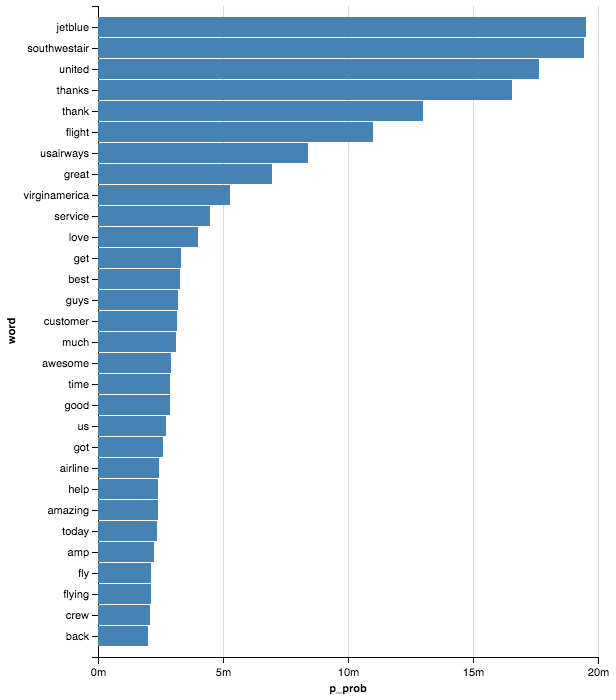

In [27]:
Chart(model.head(30)).mark_bar().encode(
    y = Y('word', sort=SortField(field='p_prob', order='descending', op='sum')),
    x = 'p_prob'
)

In [38]:
from scipy.misc import imread
airplane_mask = imread(os.path.join("/home/faculty/millbr02", "airplane.jpg"))

In [28]:
patt = re.compile(r'united|usairways|delta|southwestair|virginamerica|americanair|jetblue')

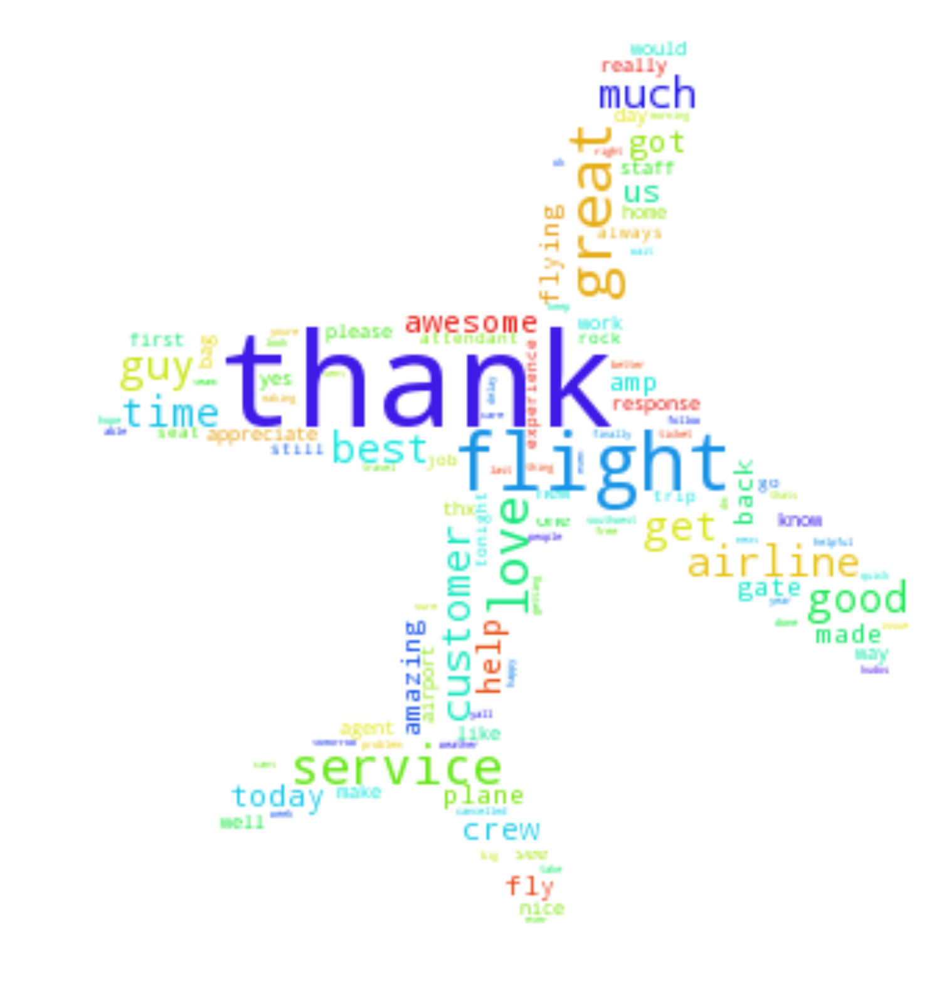

In [40]:
fig, ax = plt.subplots(figsize=(36, 20))
wcp = WordCloud(stopwords=sw,mask=airplane_mask,background_color='white').generate(re.sub(patt,''," ".join(tweets[tweets.airline_sentiment == 'positive'].clean_text)))
ax.axis('off')
ax.imshow(wcp)

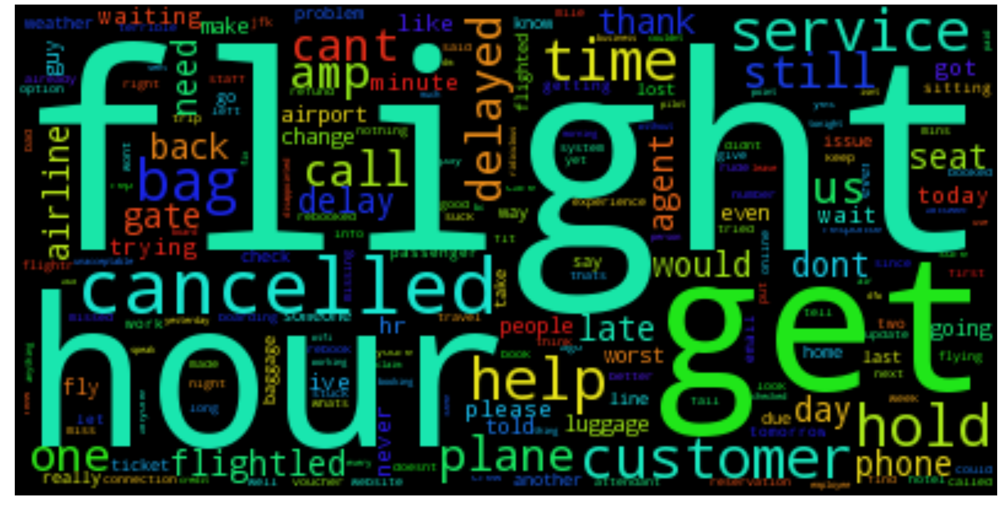

In [44]:
fig, ax = plt.subplots(figsize=(36, 20))
wcn = WordCloud(stopwords=sw).generate(re.sub(patt,''," ".join(tweets[tweets.airline_sentiment == 'negative'].clean_text)))
ax.axis('off')
ax.imshow(wcn)


In [71]:
newmod = model.set_index('word')

In [85]:
def predict(tweet):
    pos = 1.0
    neg = 1.0
    for word in [w for w in tweet.split() if w not in sw]:
        if word in newmod.index:
            pos = pos * newmod.loc[word].p_prob
            neg = neg * newmod.loc[word].n_prob
    if math.isnan(pos) or math.isnan(neg):
        print("NAN")
    if pos > neg:
        return 'positive'
    return 'negative'


In [79]:
predict(test_set.iloc[1].clean_text)


'negative'

In [86]:
t = test_set[(test_set.airline_sentiment == 'positive') | (test_set.airline_sentiment == 'negative')]
t['prediction'] = t.apply(lambda x: predict(x.clean_text), axis=1)

/usr/local/lib/python3.5/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [87]:
t['correct'] = t.prediction == t.airline_sentiment

/usr/local/lib/python3.5/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [89]:
t.correct.mean()

0.93090760425183972

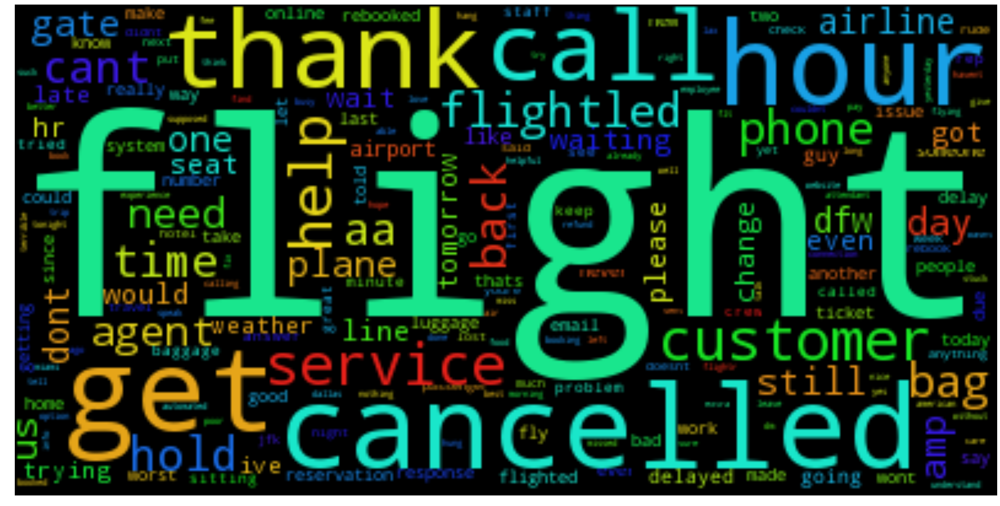

In [90]:
fig, ax = plt.subplots(figsize=(36, 20))
wcn = WordCloud(stopwords=sw).generate(re.sub(patt,''," ".join(t[t.correct == True].clean_text)))
ax.axis('off')
ax.imshow(wcn)
